##Connecting to Drive

In [1]:
from google.colab import drive
drive.mount('/content/drive/', force_remount=True)

Mounted at /content/drive/


In [2]:
path_to_folder = "ENPM673/project_3/"
%cd /content/drive/My\ Drive/{path_to_folder}

/content/drive/My Drive/ENPM673/project_3


##Importing Dependencies

In [3]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
from scipy.signal import convolve2d
from google.colab.patches import cv2_imshow
from IPython.display import clear_output
import glob

## Problem 2 - Stereo Vision System

Note : At the moment only Traproom results is displayed. Uncomment the following code to display all the results

#### Loading Images

In [4]:
# Load images
trp_img1 = cv2.imread('traproom/im0.png')
trp_img2 = cv2.imread('traproom/im1.png')

str_img1 = cv2.imread('storageroom/im0.png')
str_img2 = cv2.imread('storageroom/im0.png')

cls_img1 = cv2.imread('classroom/im0.png')
cls_img2 = cv2.imread('classroom/im0.png')


#### Converting Images to Grayscale

In [5]:
# Convert images to grayscale
trp_gray1 = cv2.cvtColor(trp_img1,cv2.COLOR_BGR2GRAY)
trp_gray2 = cv2.cvtColor(trp_img2, cv2.COLOR_BGR2GRAY)

str_gray1 = cv2.cvtColor(str_img1, cv2.COLOR_BGR2GRAY)
str_gray2 = cv2.cvtColor(str_img2, cv2.COLOR_BGR2GRAY)

cls_gray1 = cv2.cvtColor(cls_img1, cv2.COLOR_BGR2GRAY)
cls_gray2 = cv2.cvtColor(cls_img2, cv2.COLOR_BGR2GRAY)

#### Feature Extraction
The SIFT (Scale-Invariant Feature Transform) algorithm is used to detect keypoints and compute descriptors for each image. These keypoints and descriptors are then matched between pairs of images using a KNN (K-Nearest Neighbors) matching algorithm.

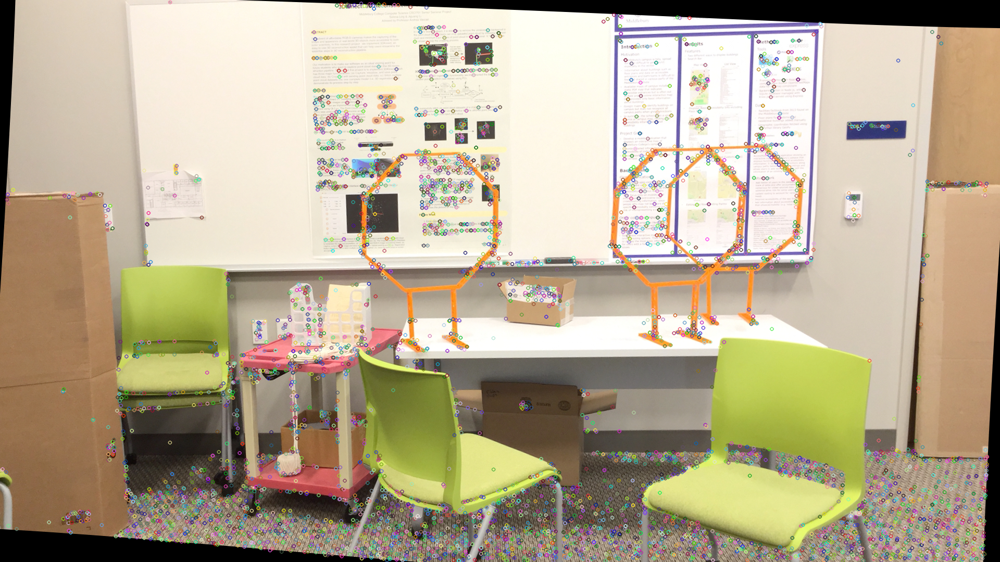

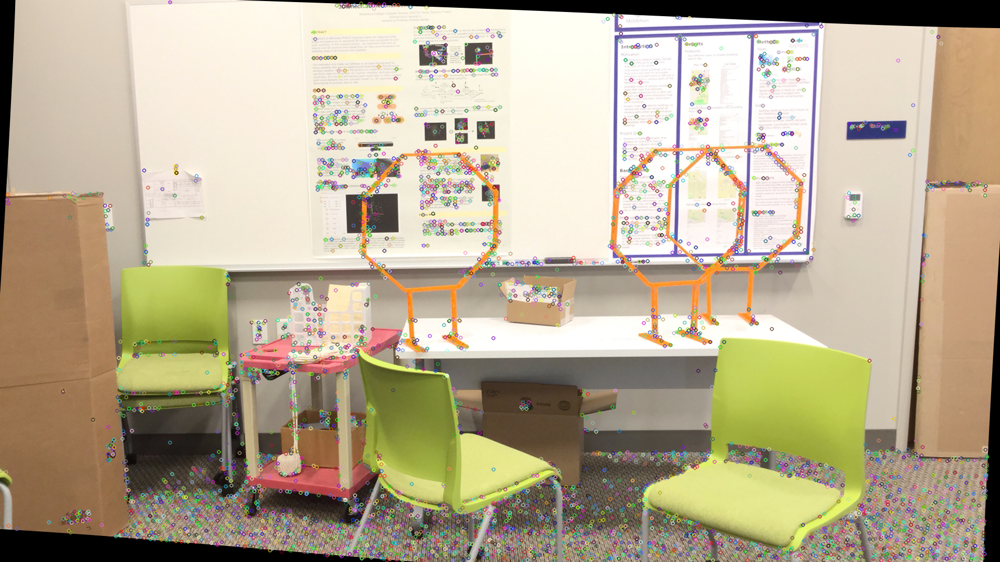

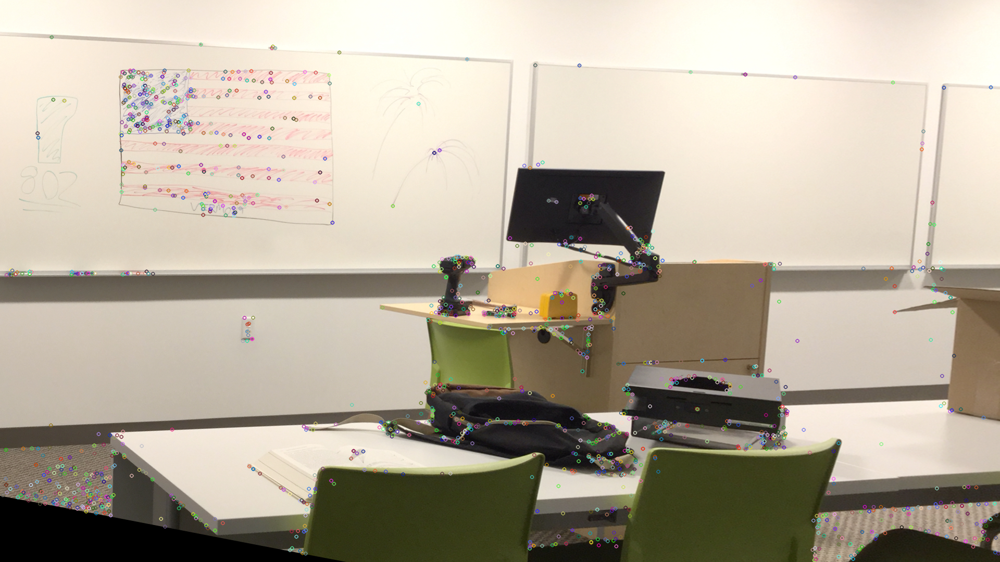

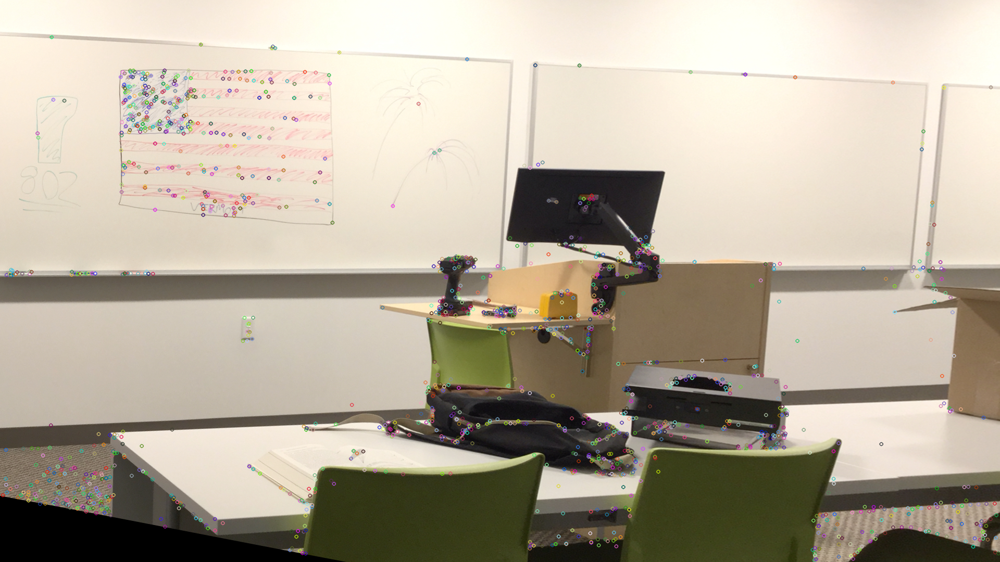

In [6]:
sift = cv2.SIFT_create()

#Finding keypoints and descriptors
kp_trp1, des_trp1 = sift.detectAndCompute(trp_gray1, None)
kp_trp2, des_trp2 = sift.detectAndCompute(trp_gray2, None)

kp_str1, des_str1 = sift.detectAndCompute(str_gray1, None)
kp_str2, des_str2 = sift.detectAndCompute(str_gray2, None)

kp_cls1, des_cls1 = sift.detectAndCompute(cls_gray1, None)
kp_cls2, des_cls2 = sift.detectAndCompute(cls_gray2, None)

#Displaying the feature detected in traproom image
# cv2_imshow(cv2.drawKeypoints(trp_img1,kp_trp1,None))
# cv2_imshow(cv2.drawKeypoints(trp_img2,kp_trp2,None))

# #Displaying the feature detected in storeroom image
cv2_imshow(cv2.drawKeypoints(str_img1,kp_str1,None))
cv2_imshow(cv2.drawKeypoints(str_img2,kp_str2,None))

# #Displaying the feature detected in classroom image
cv2_imshow(cv2.drawKeypoints(cls_img1,kp_cls1,None))
cv2_imshow(cv2.drawKeypoints(cls_img2,kp_cls2,None))


#### Feature Matching

In [7]:
#feature matching
def match_features(descriptors1, descriptors2):

  # finding nearest match with KNN algorithm
  index_params = dict(algorithm=0, trees=5)
  search_params = dict(checks=50)

  flann = cv2.FlannBasedMatcher(index_params, search_params)

  Matches = flann.knnMatch(descriptors1, descriptors2, k=2)

  # Apply ratio test to get good matches
  good_matches = []
  for (m, n) in Matches:
      if m.distance < 0.7 * n.distance:
          good_matches.append(m)

  # Need to draw only good matches, so create a mask
  # This list is required for drawMatchesKnn()
  good_list = [[0, 0] for i in range(len(Matches))]

  for i, (j, k) in enumerate(Matches):
      if j.distance < 0.7*k.distance:
          good_list[i] = [1, 0]

  return Matches, good_matches, good_list

t_matches_trap_1_2, g_matches_trap_1_2,g_list_trap_1_2= match_features(des_trp1, des_trp2)

t_matches_str_1_2, g_matches_str_1_2,g_list_str_1_2= match_features( des_str1,  des_str2)

t_matches_cls_1_2, g_matches_cls_1_2,g_list_cls_1_2= match_features(des_cls1, des_cls2)

#### Displaying the Feature Matching

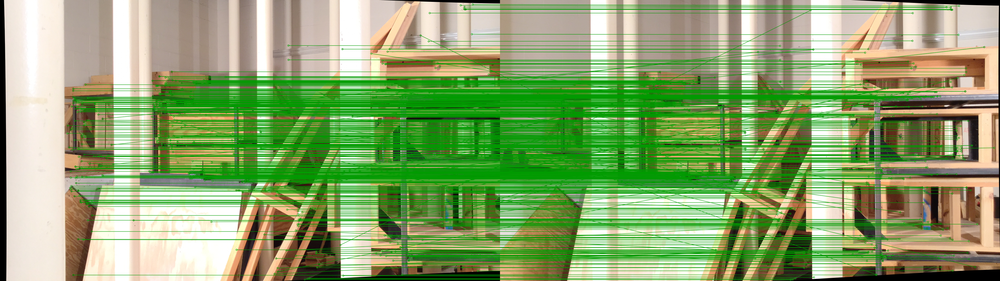

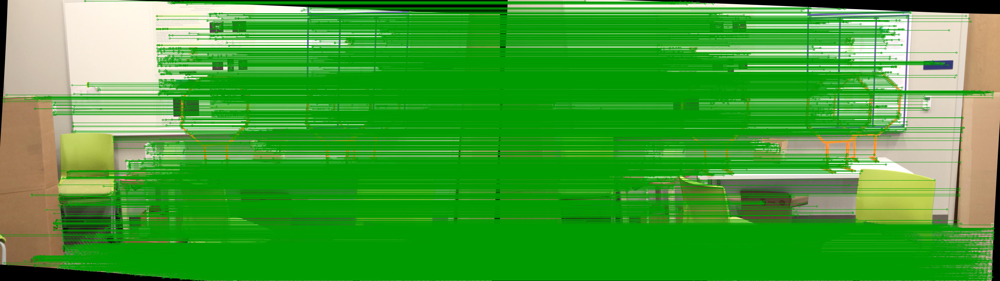

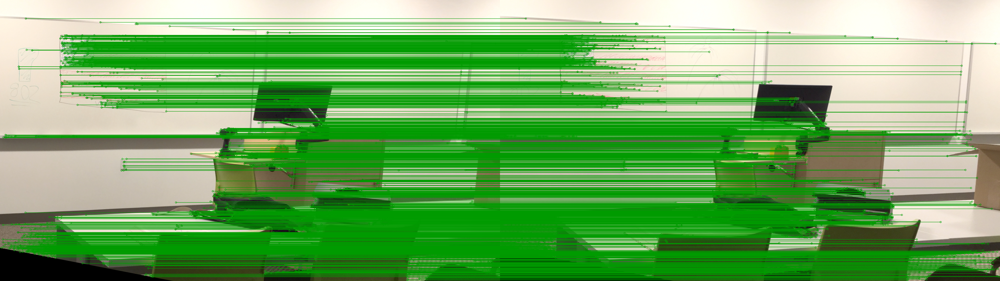

In [ ]:
def display_feature(image1,kp1,image2,kp2,t_matches1_2,g_list1_2):
  #Displaying featuring matching in image1 and image2
  Matched_1_2 = cv2.drawMatchesKnn(image1,
                              kp1,
                              image2,
                              kp2,
                              t_matches1_2,
                              outImg=None,
                              matchColor=(0, 155, 0),
                              singlePointColor=None,
                              matchesMask=g_list1_2,
                              flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
                              )
  cv2_imshow(Matched_1_2)


#Traproom
display_feature(trp_img1,kp_trp1,trp_img2,kp_trp2,t_matches_trap_1_2,g_list_trap_1_2)

#Uncomment to Display feature matching in storeroom (image1 - image2) and classroom(image1 - image2)
#Storeroom
display_feature(str_img1,kp_str1,str_img2,kp_str2,t_matches_str_1_2,g_list_str_1_2)

#Classroom
display_feature(cls_img1,kp_cls1,cls_img2,kp_cls2,t_matches_cls_1_2,g_list_cls_1_2)



#### Calculating the Fundamental Matrix using RANSAC
* The fundamental matrix describes the geometric relationship between image pairs.
* It is essential for establishing correspondences between image points and estimating relative camera pose, crucial for stereo reconstruction and 3D scene understanding.

In [ ]:
def estimate_fundamental_matrix(matches, keypoints1, keypoints2, threshold=1.0):
    # Convert keypoints to numpy arrays
    # pts1 = np.float32([keypoints1[m.queryIdx].pt for m in matches]).reshape(-1, 2)
    # pts2 = np.float32([keypoints2[m.trainIdx].pt for m in matches]).reshape(-1, 2)

    pts1 = []
    pts2 = []

    for m,n in matches:
      if m.distance < 0.75*n.distance:
        pts1.append(keypoints1[m.queryIdx].pt)
        pts2.append(keypoints2[m.trainIdx].pt)

    pts1 = np.array(pts1)
    pts2 = np.array(pts2)

    # Estimate fundamental matrix using RANSAC
    F, mask = cv2.findFundamentalMat(pts1, pts2, cv2.FM_RANSAC, threshold, 0.99)

    return F, mask,pts1,pts2

# Estimate Fundamental matrix for traproom images
# F_trp, mask_trp,pts1_trp,pts2_trp = estimate_fundamental_matrix(g_matches_trap_1_2, kp_trp1, kp_trp2)
F_trp, mask_trp,pts1_trp,pts2_trp = estimate_fundamental_matrix(t_matches_trap_1_2, kp_trp1, kp_trp2)

# Estimate Fundamental matrix for storeroom images
# F_str, mask_str,pts1_str,pts2_str = estimate_fundamental_matrix(g_matches_str_1_2, kp_str1, kp_str2)
F_str, mask_str,pts1_str,pts2_str = estimate_fundamental_matrix(t_matches_str_1_2, kp_str1, kp_str2)

# Estimate Fundamental matrix for classroom images
# F_cls, mask_cls,pts1_cls,pts2_cls = estimate_fundamental_matrix(g_matches_cls_1_2, kp_cls1, kp_cls2)
F_cls, mask_cls,pts1_cls,pts2_cls = estimate_fundamental_matrix(t_matches_cls_1_2, kp_cls1, kp_cls2)

# Print Fundamental matrix and mask for Traproom
print("Fundamental Matrix for Traproom Images:")
print(F_trp)

# # Print Fundamental matrix and mask for storeroom
# print("Fundamental Matrix for Storeroom Images:")
# print(F_str)

# # Print Fundamental matrix and mask for classroom
# print("Fundamental Matrix for Classroom Images:")
# print(F_cls)

Fundamental Matrix for Traproom Images:
[[-1.97247876e-10 -1.82079847e-06  9.72484453e-04]
 [ 2.54063316e-06  2.59653804e-06  1.79074210e-01]
 [-1.37976785e-03 -1.82755428e-01  1.00000000e+00]]


#### Compute essential matrix using fundamental matrix
Essential matrix encapsulates essential geometric information necessary for reconstructing the 3D structure of a scene from a pair of images.

In [ ]:
def compute_essential_matrix(F, calib_file_path):
    # Load the camera calibration parameters
    with open(calib_file_path, 'r') as file:
        calib_data = file.read()

    # Extract the camera matrices
    cam0_params = calib_data.split('cam0=')[1].split('cam1=')[0].strip()[1:-1].split(';')
    cam1_params = calib_data.split('cam1=')[1].split('doffs=')[0].strip()[1:-1].split(';')

    cam0_matrix = np.array([list(map(float, row.split())) for row in cam0_params])
    cam1_matrix = np.array([list(map(float, row.split())) for row in cam1_params])

    # Compute the Essential matrix
    E = cam1_matrix.T @ F @ cam0_matrix

    return E,cam0_matrix,calib_data

# Compute Essential matrix for traproom
E_trap,cam0_matrix_trap,calib_data_trp = compute_essential_matrix(F_trp, 'traproom/calib.txt')
print("Essential Matrix for Traproom Images:")
print(E_trap)

# Compute Essential matrix for storeroom
E_str,cam0_matrix_str,calib_data_str = compute_essential_matrix(F_str, 'storageroom/calib.txt')
# print("Essential Matrix for Storageproom Images:")
# print(E_str)

# Compute Essential matrix for classroom
E_cls,cam0_matrix_cls,calib_data_cls = compute_essential_matrix(F_cls, 'classroom/calib.txt')
# print("Essential Matrix for Classroom Images:")
# print(E_cls)

Essential Matrix for Traproom Images:
[[-6.17273768e-04 -5.69806457e+00  2.18708260e-02]
 [ 7.95073810e+00  8.12568862e+00  3.24923745e+02]
 [-7.19516104e-02 -3.24973338e+02 -2.54716879e-01]]


#### Decompose the Essential matrix into rotation and translation matrices

In [ ]:
# Decompose the Essential matrix for traproom
_, R_trap, t_trap, _ = cv2.recoverPose(E_trap, pts1_trp, pts2_trp, cam0_matrix_trap)

# Decompose the Essential matrix for storeroom
_, R_str, t_str, _ = cv2.recoverPose(E_str, pts1_str, pts2_str, cam0_matrix_str)

# Decompose the Essential matrix for classroom
_, R_cls, t_cls, _ = cv2.recoverPose(E_cls, pts1_cls, pts2_cls, cam0_matrix_cls)


#Print the rotation and tralation matrices
print("Rotation Matrix for traproom :")
print(R_trap)
print("Translation Matrix for traproom :")
print(t_trap)

# print("\n \n Rotation Matrix for storageroom :")
# print(R_str)
# print("Translation Matrix for storageroom :")
# print(t_str)

# print("\n \nRotation Matrix for classroom :")
# print(R_cls)
# print("Translation Matrix for classroom :")
# print(t_cls)


Rotation Matrix for traproom :
[[ 9.99975999e-01  9.11357332e-05 -6.92765053e-03]
 [-1.74991607e-04  9.99926718e-01 -1.21048763e-02]
 [ 6.92603967e-03  1.21057980e-02  9.99902735e-01]]
Translation Matrix for traproom :
[[-9.99846277e-01]
 [ 8.10451244e-05]
 [ 1.75332759e-02]]


### Rectification
* It transforms images to a common reference frame where corresponding image points lie on the same scanline.

* Simplifies stereo matching and depth calculation by ensuring epipolar lines are aligned horizontally, simplifying correspondence search.

In [ ]:
def rectify_images(pts1, pts2, F, img_shape):
    # Compute fundamental matrix
    _, H1, H2 = cv2.stereoRectifyUncalibrated(pts1, pts2, F, img_shape)

    return H1, H2

# Rectify images for traproom
H1_trp, H2_trp = rectify_images(pts1_trp, pts2_trp, F_trp, img_shape =(trp_img1.shape[1],trp_img1.shape[0]))

# Rectify images for storeroom
H1_str, H2_str = rectify_images(pts1_str, pts2_str, F_str, img_shape =(str_img1.shape[1],str_img1.shape[0]))

# Rectify images for classroom
H1_cls, H2_cls = rectify_images(pts1_cls, pts2_cls, F_cls, img_shape =(cls_img1.shape[1],cls_img1.shape[0]))

# Print homography matrices for traproom
print("Homography Matrix H1 for Traproom:")
print(H1_trp)
print("Homography Matrix H2 for Traproom:")
print(H2_trp)

# Print homography matrices for storeroom
print("\n \n Homography Matrix H1 for Storeroom:")
print(H1_str)
print("Homography Matrix H2 for Storeroom:")
print(H2_str)

# Print homography matrices for classroom
print("\n \n Homography Matrix H1 for Classroom:")
print(H1_cls)
print("Homography Matrix H2 for Classroom:")
print(H2_cls)


Homography Matrix H1 for Traproom:
[[-1.77658065e-01  7.71640200e-04  7.44225093e+00]
 [-1.36680413e-03 -1.82744844e-01  1.91517925e+00]
 [-2.51641709e-06 -2.57187254e-06 -1.77367317e-01]]
Homography Matrix H2 for Traproom:
[[ 1.00954582e+00  4.67085568e-05 -9.18920612e+00]
 [ 5.32325528e-03  1.00000025e+00 -5.11045865e+00]
 [ 9.94355960e-06  4.60057692e-10  9.90453934e-01]]

 
 Homography Matrix H1 for Storeroom:
[[-1.79666706e-02  3.94220171e-02 -2.30445599e+01]
 [-2.35021013e-02  3.83218683e-03  9.80250703e+00]
 [-1.01633272e-05  2.23001172e-05 -2.20818050e-02]]
Homography Matrix H2 for Storeroom:
[[ 9.07566389e-01 -1.99135937e+00  1.16407033e+03]
 [ 1.18718252e+00 -1.93578657e-01 -4.95162745e+02]
 [ 5.13389174e-04 -1.12646563e-03  1.11543783e+00]]

 
 Homography Matrix H1 for Classroom:
[[-7.89830905e-03  2.96056568e-03  2.36528852e+00]
 [-3.78046381e-03 -2.60818311e-03  3.00232387e+00]
 [-4.55099398e-06  1.70587356e-06 -3.21366149e-04]]
Homography Matrix H2 for Classroom:
[[ 2.095

#### Apply perspective transformation to rectify images

In [ ]:
# Apply perspective transformation to rectify images using homography matrices H1 and H2
rect_img1_trp = cv2.warpPerspective(trp_img1, H1_trp, (trp_img1.shape[1], trp_img1.shape[0]))
rect_img2_trp = cv2.warpPerspective(trp_img2, H2_trp, (trp_img2.shape[1], trp_img2.shape[0]))

rect_img1_str = cv2.warpPerspective(str_img1, H1_str, (str_img1.shape[1], str_img1.shape[0]))
rect_img2_str = cv2.warpPerspective(str_img2, H2_str, (str_img2.shape[1], str_img2.shape[0]))

rect_img1_cls = cv2.warpPerspective(cls_img1, H1_cls, (cls_img1.shape[1], cls_img1.shape[0]))
rect_img2_cls = cv2.warpPerspective(cls_img2, H2_cls, (cls_img2.shape[1], cls_img2.shape[0]))

#### Visualize epipolar lines and feature points on both rectified images.

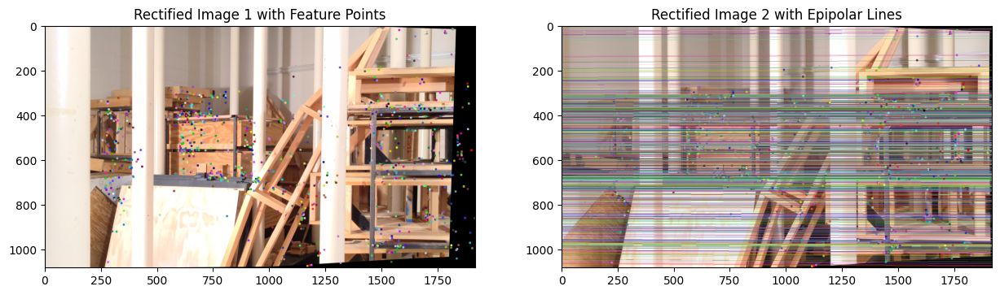

In [ ]:
def visualize(img1_rect, img2_rect, pts1, pts2,F):
    # Draw epipolar lines on the rectified images
    lines2 = cv2.computeCorrespondEpilines(pts1.reshape(-1, 1, 2), 1, F)
    lines2 = lines2.reshape(-1, 3)
    img1_rect_lines = img1_rect.copy()
    img2_rect_lines = img2_rect.copy()

    for r, pt1, pt2 in zip(lines2, pts1, pts2):
        color = tuple(np.random.randint(0, 255, 3).tolist())
        x0, y0 = map(int, [0, -r[2]/r[1]])
        x1, y1 = map(int, [img2_rect.shape[1], -(r[2]+r[0]*img2_rect.shape[1])/r[1]])
        img2_rect_lines = cv2.line(img2_rect_lines, (x0, y0), (x1, y1), color, 1)
        img2_rect_lines = cv2.circle(img2_rect_lines, tuple(map(int, pt2)), 5, color, -1)
        img1_rect_lines = cv2.circle(img1_rect_lines, tuple(map(int, pt1)), 5, color, -1)

    # Display the rectified images with epipolar lines and feature points
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 2, 1)
    # plt.imshow(img1_rect_lines)
    plt.imshow(cv2.cvtColor(img1_rect_lines, cv2.COLOR_BGR2RGB))
    plt.title('Rectified Image 1 with Feature Points')
    plt.subplot(1, 2, 2)
    # plt.imshow(img2_rect_lines)
    plt.imshow(cv2.cvtColor(img2_rect_lines, cv2.COLOR_BGR2RGB))
    plt.title('Rectified Image 2 with Epipolar Lines')
    plt.show()

# Visualize epipolar lines and feature points for traproom
visualize(rect_img1_trp, rect_img2_trp, pts1_trp, pts2_trp, F_trp)

# # Visualize epipolar lines and feature points for storeroom
# visualize(rect_img1_str, rect_img2_str, pts1_str, pts2_str, F_str)

# # Visualize epipolar lines and feature points for classroom
# visualize(rect_img1_cls, rect_img2_cls, pts1_cls, pts2_cls, F_cls)


#### Calculate the disparity map
* Compute the disparity (horizontal shift) between corresponding points in rectified stereo images.

* Provides a dense map of depth information, crucial for understanding scene geometry and reconstructing 3D structures.

In [ ]:
def calculate_disparity_map(img1_rect, img2_rect):
    # Convert images to grayscale
    img1_gray = cv2.cvtColor(img1_rect, cv2.COLOR_BGR2GRAY)
    img2_gray = cv2.cvtColor(img2_rect, cv2.COLOR_BGR2GRAY)

    # Define stereo matching algorithm parameters
    min_disparity = 0
    num_disparities = 64
    block_size = 5

    # Create StereoSGBM object
    stereo = cv2.StereoSGBM_create(
        minDisparity=min_disparity,
        numDisparities=num_disparities,
        blockSize=block_size
    )

    # Compute disparity map
    disparity = stereo.compute(img1_gray, img2_gray)

    return disparity

# Calculate disparity map for traproom
disparity_map_trp = calculate_disparity_map(rect_img1_trp, rect_img2_trp)
print("disparity map for traproom :")
print(disparity_map_trp)

# Calculate disparity map for storeroom
disparity_map_str = calculate_disparity_map(rect_img1_str, rect_img2_str)
# print("disparity map for storageroom :")
# print(disparity_map_trp)

# Calculate disparity map for classroom
disparity_map_cls = calculate_disparity_map(rect_img1_cls, rect_img2_cls)
# print("disparity map for classroom :")
# print(disparity_map_trp)

disparity map for traproom :
[[-16 -16 -16 ...   0   0   0]
 [-16 -16 -16 ...   0   0   0]
 [-16 -16 -16 ...   0   0   0]
 ...
 [-16 -16 -16 ...   0   0   0]
 [-16 -16 -16 ...   0   0   0]
 [-16 -16 -16 ...   0   0   0]]


#### Saving the disparity map as grayscale and color images using heat map conversion.


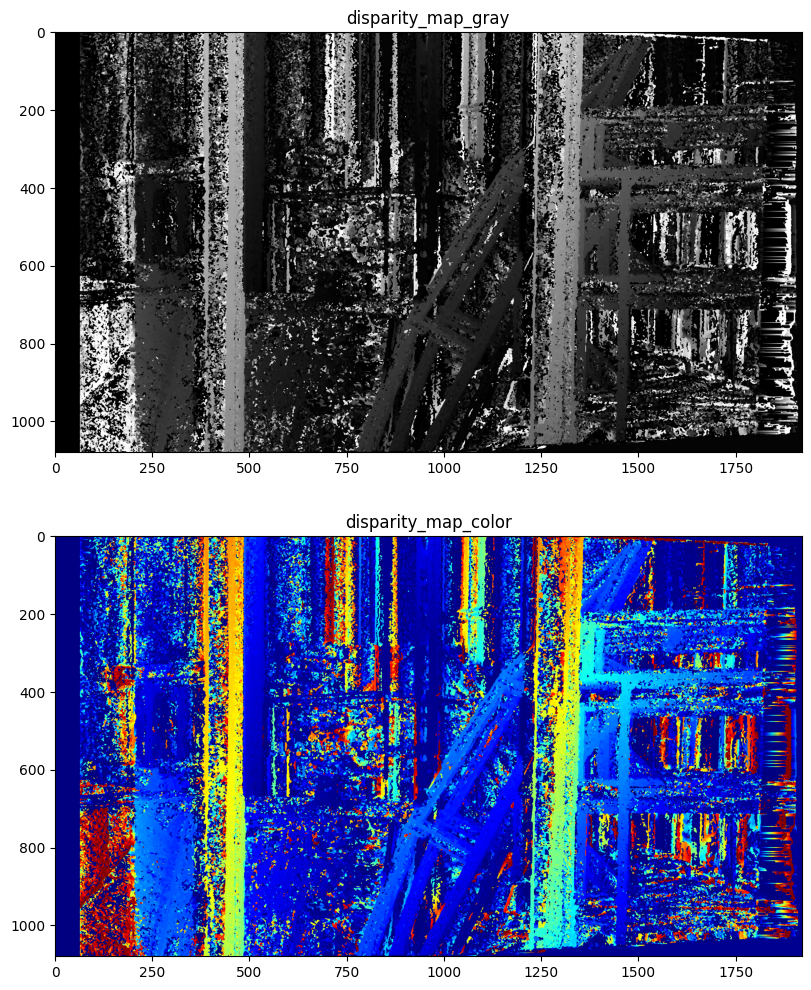

In [ ]:
def rescale_disparity_map(disparity_map):
    # Normalize the disparity map to range [0, 255]
    disparity_map_rescaled = cv2.normalize(disparity_map, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    return disparity_map_rescaled

def save_disparity_map(disparity_map, filename):
    # Convert disparity map to grayscale
    disparity_map_gray = cv2.cvtColor(disparity_map, cv2.COLOR_GRAY2BGR)

    # Apply heat map conversion
    disparity_map_color = cv2.applyColorMap(disparity_map, cv2.COLORMAP_JET)

    # Save grayscale and colorized disparity maps
    cv2.imwrite(filename + '_gray.png', disparity_map_gray)
    cv2.imwrite(filename + '_color.png', disparity_map_color)

    #Display
    # cv2_imshow(disparity_map_gray)
    # cv2_imshow(disparity_map_color)

    plt.figure(figsize=(12, 12))
    plt.subplot(2, 1, 1)
    plt.imshow(cv2.cvtColor(disparity_map_gray, cv2.COLOR_BGR2RGB))
    plt.title('disparity_map_gray')
    plt.subplot(2, 1, 2)
    plt.imshow(cv2.cvtColor(disparity_map_color, cv2.COLOR_BGR2RGB))
    plt.title('disparity_map_color')



# Rescale and save disparity map for traproom
disparity_map_rescaled_trp = rescale_disparity_map(disparity_map_trp)
save_disparity_map(disparity_map_rescaled_trp, 'disparity_map_trp')

# # Rescale and save disparity map for storeroom
# disparity_map_rescaled_str = rescale_disparity_map(disparity_map_str)
# save_disparity_map(disparity_map_rescaled_str, 'disparity_map_str')

# # Rescale and save disparity map for classroom
# disparity_map_rescaled_cls = rescale_disparity_map(disparity_map_cls)
# save_disparity_map(disparity_map_rescaled_cls, 'disparity_map_cls')

#### compute depth values for each pixel

*   Convert disparity values into metric depth values.
*    Depth maps enable quantification of distances in the scene, essential for various applications like obstacle detection, scene reconstruction, and augmented reality.



In [ ]:
def compute_depth_values(disparity_map, baseline, focal_length):
    # Compute depth values
    depth = baseline * focal_length / (disparity_map.astype(np.float32) + 1e-6)
    return depth

# Load the camera baseline and focal length for each room
baseline_trp = float(calib_data_trp.split('baseline=')[1].split('width=')[0].strip())
focal_length_trp = cam0_matrix_trap[0, 0]

baseline_str = float(calib_data_str.split('baseline=')[1].split('width=')[0].strip())
focal_length_str = cam0_matrix_str[0, 0]

baseline_cls = float(calib_data_cls.split('baseline=')[1].split('width=')[0].strip())
focal_length_cls = cam0_matrix_cls[0, 0]

# Compute depth values for each room
depth_trp = compute_depth_values(disparity_map_trp, baseline_trp, focal_length_trp)
print(depth_trp)

depth_str = compute_depth_values(disparity_map_str, baseline_str, focal_length_str)
depth_cls = compute_depth_values(disparity_map_cls, baseline_cls, focal_length_cls)


[[-3.2664957e+04 -3.2664957e+04 -3.2664957e+04 ...  5.2263928e+11
   5.2263928e+11  5.2263928e+11]
 [-3.2664957e+04 -3.2664957e+04 -3.2664957e+04 ...  5.2263928e+11
   5.2263928e+11  5.2263928e+11]
 [-3.2664957e+04 -3.2664957e+04 -3.2664957e+04 ...  5.2263928e+11
   5.2263928e+11  5.2263928e+11]
 ...
 [-3.2664957e+04 -3.2664957e+04 -3.2664957e+04 ...  5.2263928e+11
   5.2263928e+11  5.2263928e+11]
 [-3.2664957e+04 -3.2664957e+04 -3.2664957e+04 ...  5.2263928e+11
   5.2263928e+11  5.2263928e+11]
 [-3.2664957e+04 -3.2664957e+04 -3.2664957e+04 ...  5.2263928e+11
   5.2263928e+11  5.2263928e+11]]


#### Generate a depth image. And saving depth image as grayscale and color

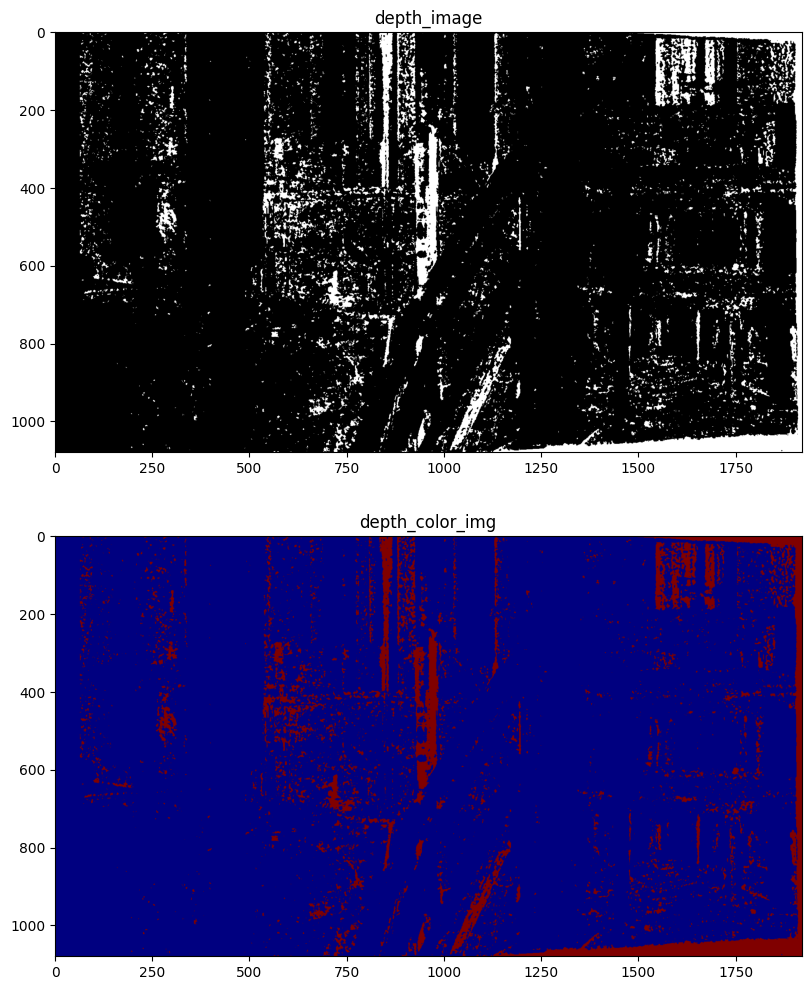

In [ ]:
def generate_depth_image(depth_values):
    # Normalize depth values to range [0, 255]
    depth_normalized = cv2.normalize(depth_values, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    return depth_normalized

def save_depth_image(depth_image, filename_prefix):
    # Convert depth image to color for visualization
    depth_color = cv2.applyColorMap(depth_image, cv2.COLORMAP_JET)

    # Save grayscale and colorized depth images
    cv2.imwrite(filename_prefix + '_depth_gray.png', depth_image)
    cv2.imwrite(filename_prefix + '_depth_color.png', depth_color)

    #Display
    # cv2_imshow(depth_image)
    # cv2_imshow(depth_color)

    plt.figure(figsize=(12, 12))
    plt.subplot(2, 1, 1)
    plt.imshow(cv2.cvtColor(depth_image, cv2.COLOR_BGR2RGB))
    plt.title('depth_image')
    plt.subplot(2, 1, 2)
    plt.imshow(cv2.cvtColor(depth_color, cv2.COLOR_BGR2RGB))
    plt.title('depth_color_img')



# Generate depth image for traproom
depth_image_trp = generate_depth_image(depth_trp)
# Save depth images for traproom
save_depth_image(depth_image_trp, 'depth_image_trp')

# # Generate depth image for storeroom
# depth_image_str = generate_depth_image(depth_str)
# # Save depth images for storeroom
# save_depth_image(depth_image_str, 'depth_image_str')

# # Generate depth image for classroom
# depth_image_cls = generate_depth_image(depth_cls)
# # Save depth images for classroom
# save_depth_image(depth_image_cls, 'depth_image_cls')
